In [1]:
# Install packages without displaying output on Windows
!pip install scikit-learn Librosa xgboost > nul 2>&1


In [2]:
import os
import librosa
import librosa.display
import numpy as np
import pandas as pd
from IPython.display import display
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier  #use MLPClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import precision_score, recall_score, f1_score, classification_report
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import VotingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import LabelEncoder



import warnings
warnings.filterwarnings("ignore")




In [3]:
def load_and_display_csv(csv_file_path):
    # Load the CSV file into a DataFrame
    data = pd.read_csv(csv_file_path)

    # Display the first 20 rows of the DataFrame
    print("First 20 rows of the dataset:")
    display(data.head(20))

    # Display information about the DataFrame
    print("\nDataFrame Information:")
    display(data.info())

    # Print statistical summary of the DataFrame
    print("\nStatistical summary of the dataset:")
    display(data.describe())

# Specify the path to your CSV file
csv_file_path = "genres_output.csv"  # Update with the path to your CSV file

# Call the function to load and display the CSV file, and print the statistical summary
load_and_display_csv(csv_file_path)


First 20 rows of the dataset:


,chroma_energy,mfcc,chroma_stft,zero_crossing_rate,spectral_centroid,spectral_rolloff,genre
0,0.275,-3.730,0.544,0.090,2175.901,4866.504,blues
1,0.275,-4.613,0.487,0.111,2274.846,4984.937,blues
2,0.273,-3.978,0.376,0.124,2093.052,4521.973,blues
3,0.280,-4.224,0.373,0.122,2088.211,4489.673,blues
4,0.280,-4.662,0.403,0.106,2218.008,4694.238,blues
5,0.289,-4.529,0.354,0.087,2172.414,4468.140,blues
6,0.280,-2.250,0.559,0.071,2199.963,4995.703,blues
7,0.289,-1.316,0.518,0.061,2096.821,5049.536,blues
8,0.275,-0.886,0.546,0.053,2122.382,5232.568,blues
9,0.273,-0.577,0.619,0.045,1875.687,4640.405,blues



DataFrame Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   chroma_energy       10000 non-null  float64
 1   mfcc                10000 non-null  float64
 2   chroma_stft         10000 non-null  float64
 3   zero_crossing_rate  10000 non-null  float64
 4   spectral_centroid   10000 non-null  float64
 5   spectral_rolloff    10000 non-null  float64
 6   genre               10000 non-null  object 
dtypes: float64(6), object(1)
memory usage: 547.0+ KB


None


Statistical summary of the dataset:


,chroma_energy,mfcc,chroma_stft,zero_crossing_rate,spectral_centroid,spectral_rolloff
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,0.266754,-1.828814,0.471906,0.073811,2138.965401,4455.681611
std,0.029941,7.974328,0.181513,0.057415,880.096373,1850.033783
min,0.000000,-56.569000,0.000000,0.000000,0.000000,0.000000
25%,0.261000,-5.132500,0.326000,0.036000,1568.465500,3197.681000
50%,0.273000,-0.886000,0.467000,0.062000,1996.948500,4198.975000
75%,0.280000,3.092000,0.610000,0.096000,2540.971750,5566.333000
max,0.289000,12.159000,0.967000,0.554000,7725.125000,10228.271000


# Data Cleaning

In [4]:
def clean_and_display_dataset(input_csv):
    # Load the CSV file into a DataFrame
    data = pd.read_csv(input_csv)

    # Data cleaning operations
    # (Add your specific data cleaning steps here)

    # Example: Handling missing values by dropping them
    data.dropna(inplace=True)

    # Example: Removing duplicate rows
    data.drop_duplicates(inplace=True)

    # Print information about the cleaned dataset
    print("Cleaned Dataset Information:")
    display(data.info())

    # Display the first few rows of the cleaned dataset
    print("\nCleaned Dataset:")
    display(data.head(20))

# Specify the path to your original CSV file
input_csv_file = "genres_output.csv"

# Call the function to clean and display the dataset
clean_and_display_dataset(input_csv_file)


Cleaned Dataset Information:
<class 'pandas.core.frame.DataFrame'>
Int64Index: 9781 entries, 0 to 9999
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   chroma_energy       9781 non-null   float64
 1   mfcc                9781 non-null   float64
 2   chroma_stft         9781 non-null   float64
 3   zero_crossing_rate  9781 non-null   float64
 4   spectral_centroid   9781 non-null   float64
 5   spectral_rolloff    9781 non-null   float64
 6   genre               9781 non-null   object 
dtypes: float64(6), object(1)
memory usage: 611.3+ KB


None


Cleaned Dataset:


,chroma_energy,mfcc,chroma_stft,zero_crossing_rate,spectral_centroid,spectral_rolloff,genre
0,0.275,-3.730,0.544,0.090,2175.901,4866.504,blues
1,0.275,-4.613,0.487,0.111,2274.846,4984.937,blues
2,0.273,-3.978,0.376,0.124,2093.052,4521.973,blues
3,0.280,-4.224,0.373,0.122,2088.211,4489.673,blues
4,0.280,-4.662,0.403,0.106,2218.008,4694.238,blues
5,0.289,-4.529,0.354,0.087,2172.414,4468.140,blues
6,0.280,-2.250,0.559,0.071,2199.963,4995.703,blues
7,0.289,-1.316,0.518,0.061,2096.821,5049.536,blues
8,0.275,-0.886,0.546,0.053,2122.382,5232.568,blues
9,0.273,-0.577,0.619,0.045,1875.687,4640.405,blues


# DATA EXPLORATION AND VISUALIZATION

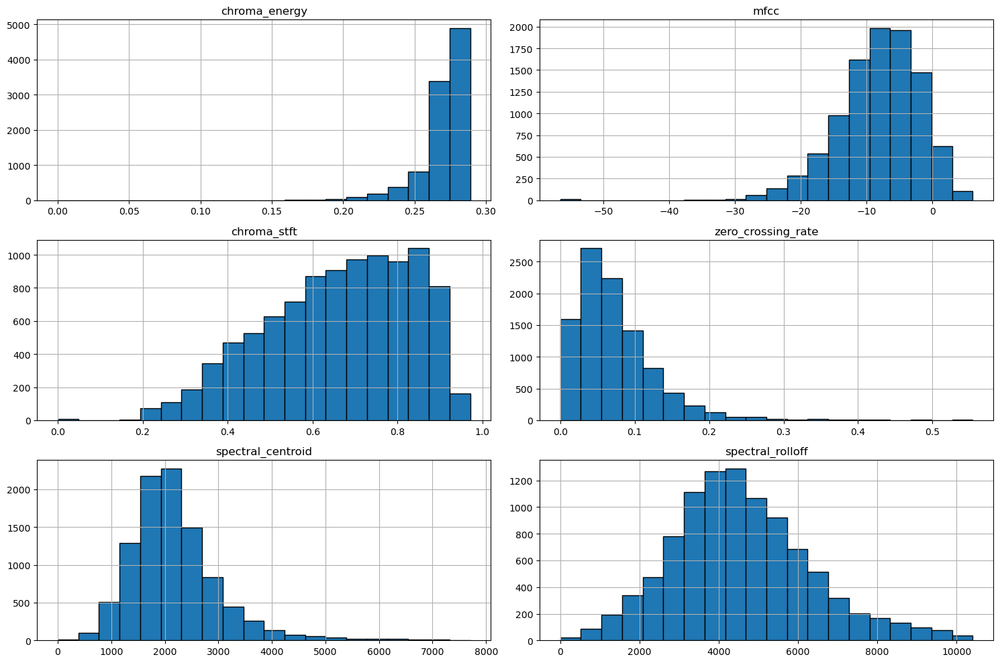

In [5]:
# Load cleaned dataset
cleaned_dataset = pd.read_csv('cleaned_dataset.csv')  # Replace 'cleaned_dataset.csv' with the actual file path

# Define the columns for which you want to create histograms
histogram_columns = ['chroma_energy', 'mfcc', 'chroma_stft', 'zero_crossing_rate', 'spectral_centroid', 'spectral_rolloff']

# Create histograms for the specified columns
def print_histograms(dataset, histogram_columns):
    dataset[histogram_columns].hist(figsize=(15, 10), bins=20, edgecolor='black')
    plt.tight_layout()
    plt.show()

# Print the histograms using the print_histograms function
print_histograms(cleaned_dataset, histogram_columns)


In [6]:
#SCATTER MATRIX

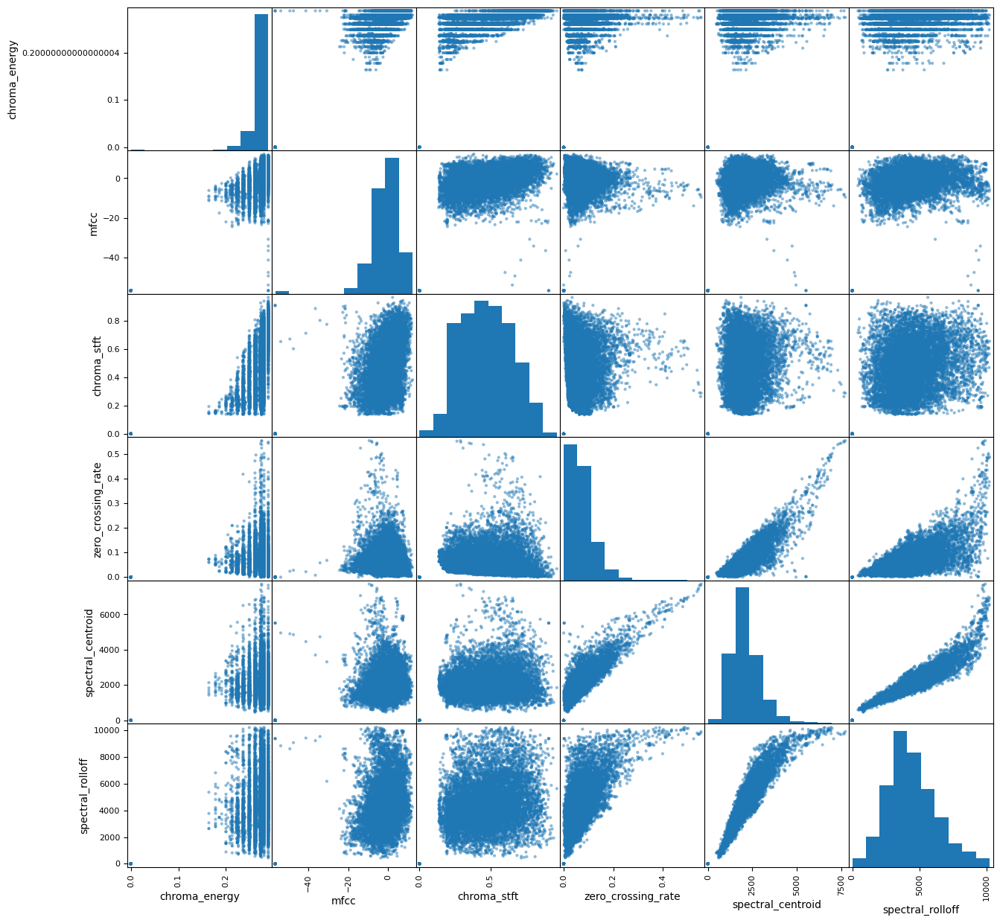

In [7]:
# Load your cleaned dataset
cleaned_dataset = pd.read_csv('genres_output.csv')  # Replace 'cleaned_dataset.csv' with the actual file path

# Specify the columns for the scatter matrix
scatter_columns = ['chroma_energy', 'mfcc', 'chroma_stft', 'zero_crossing_rate', 'spectral_centroid', 'spectral_rolloff']

# Create the scatter matrix
scatter_matrix(cleaned_dataset[scatter_columns], figsize=(15, 15), alpha=0.5, diagonal='hist')
plt.show()


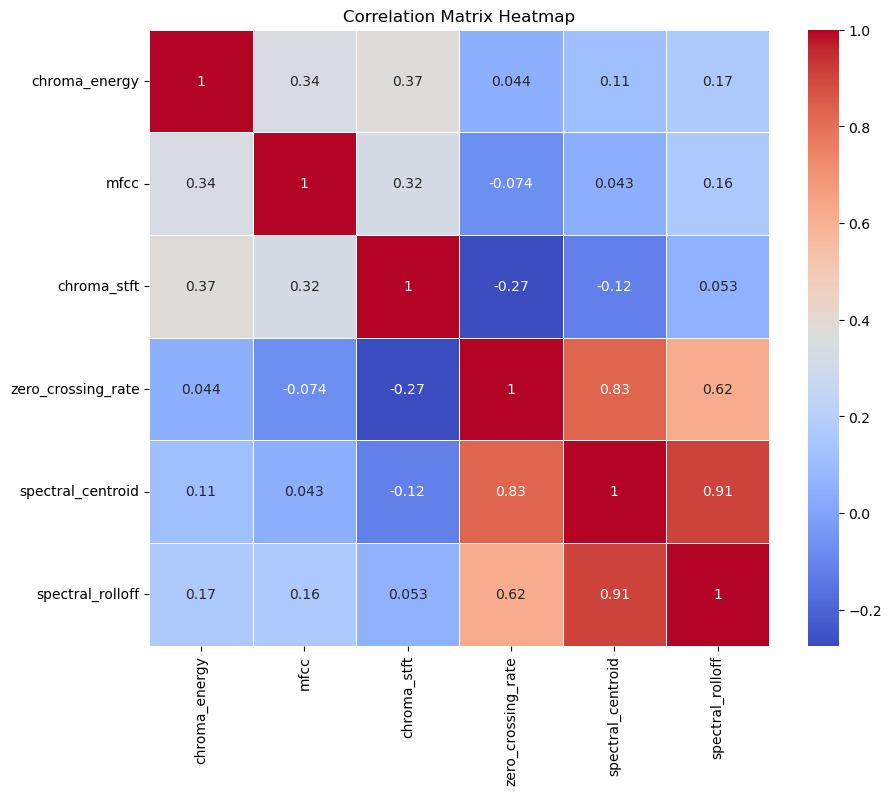

In [8]:
# Load cleaned dataset
cleaned_dataset = pd.read_csv('cleaned_dataset.csv')  # Replace 'cleaned_dataset.csv' with the actual file path

# Compute the correlation matrix
correlation_matrix = cleaned_dataset.corr(numeric_only=True)

# Create a heatmap of the correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=.5)
plt.title('Correlation Matrix Heatmap')
plt.show()



In [9]:
# Load your dataset
csv_file_path = "genres_output.csv"  # Replace with the path to your CSV file
dataset = pd.read_csv(csv_file_path)

# Calculate the correlation matrix
correlation_matrix = dataset.corr()

# Print out the correlation coefficients in text format
for column1 in correlation_matrix.columns:
    for column2 in correlation_matrix.columns:
        correlation = correlation_matrix.loc[column1, column2]
        print(f"Correlation between {column1} and {column2}: {correlation:.3f}")


Correlation between chroma_energy and chroma_energy: 1.000
Correlation between chroma_energy and mfcc: 0.713
Correlation between chroma_energy and chroma_stft: 0.497
Correlation between chroma_energy and zero_crossing_rate: 0.123
Correlation between chroma_energy and spectral_centroid: 0.246
Correlation between chroma_energy and spectral_rolloff: 0.273
Correlation between mfcc and chroma_energy: 0.713
Correlation between mfcc and mfcc: 1.000
Correlation between mfcc and chroma_stft: 0.409
Correlation between mfcc and zero_crossing_rate: 0.046
Correlation between mfcc and spectral_centroid: 0.215
Correlation between mfcc and spectral_rolloff: 0.299
Correlation between chroma_stft and chroma_energy: 0.497
Correlation between chroma_stft and mfcc: 0.409
Correlation between chroma_stft and chroma_stft: 1.000
Correlation between chroma_stft and zero_crossing_rate: -0.000
Correlation between chroma_stft and spectral_centroid: 0.164
Correlation between chroma_stft and spectral_rolloff: 0.249


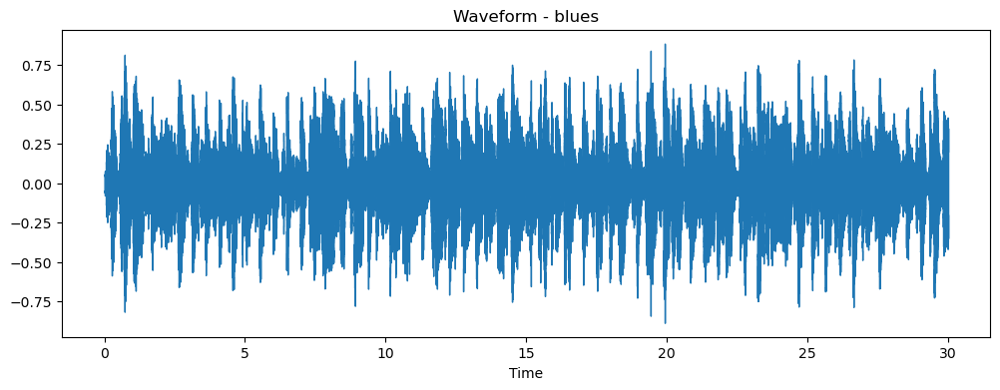

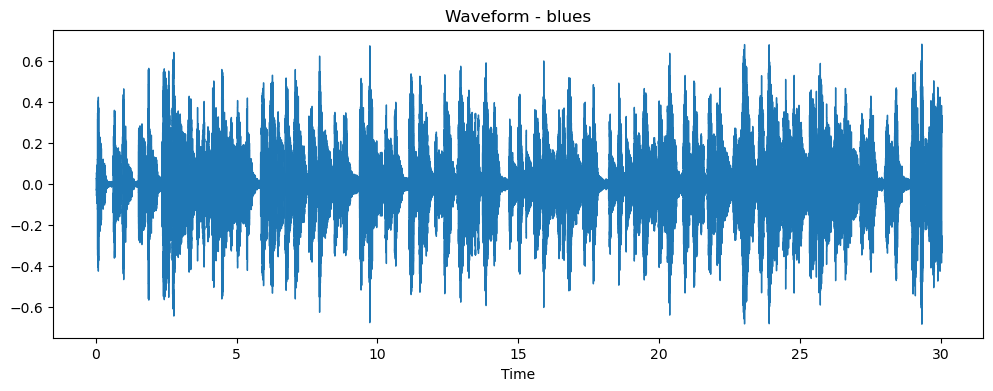

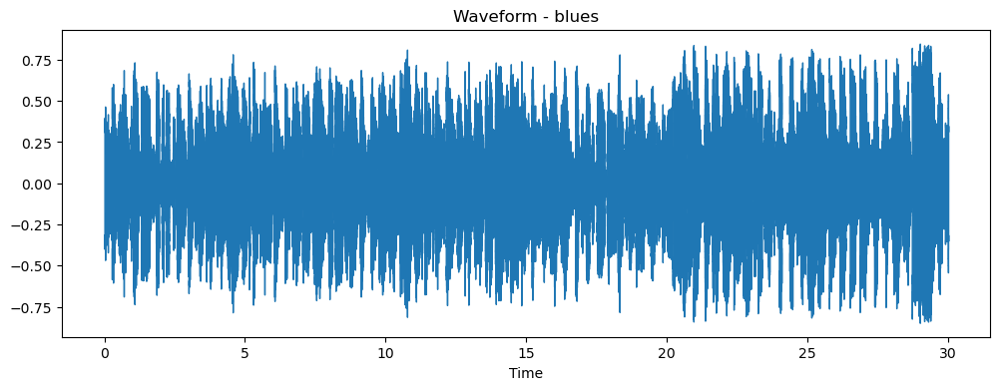

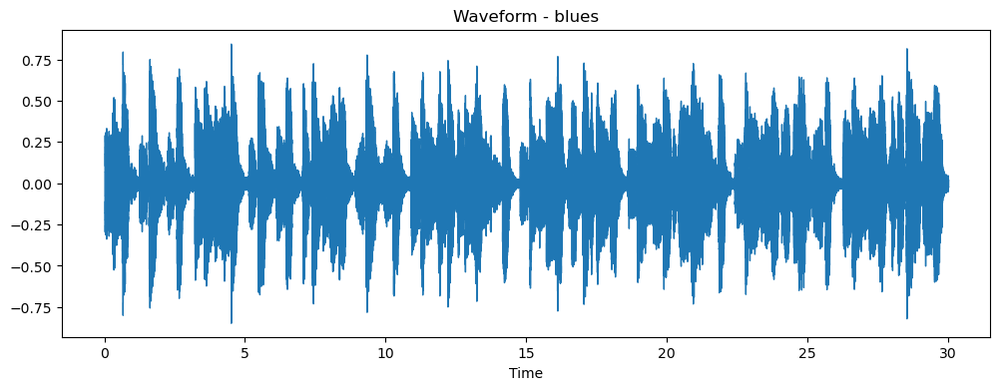

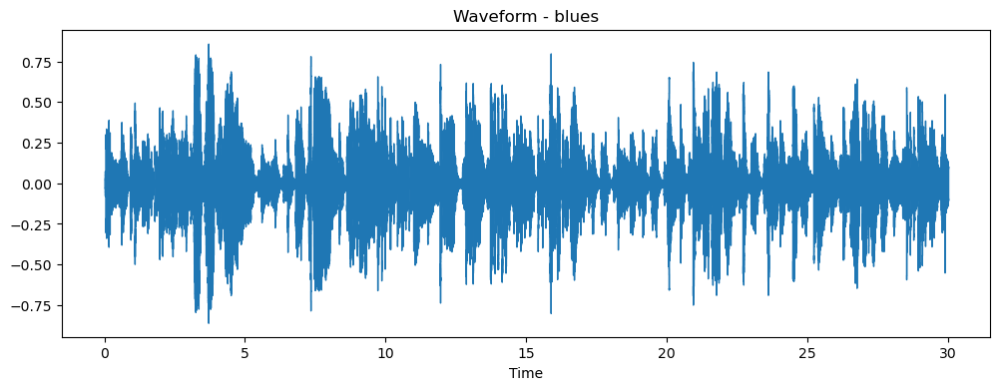

...

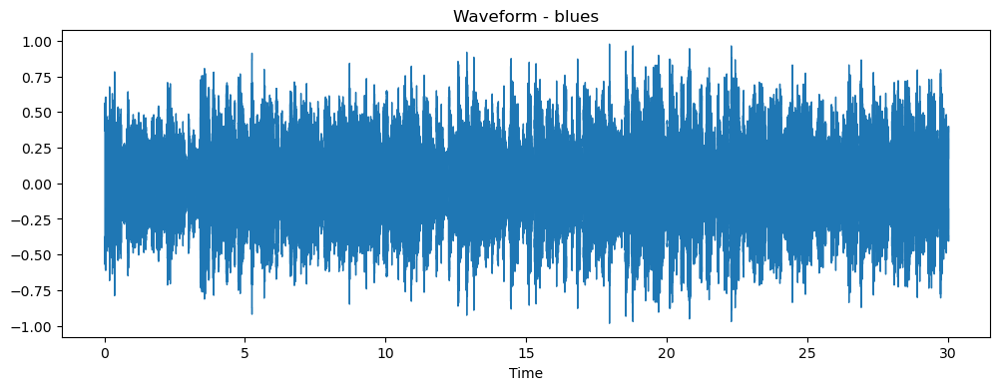

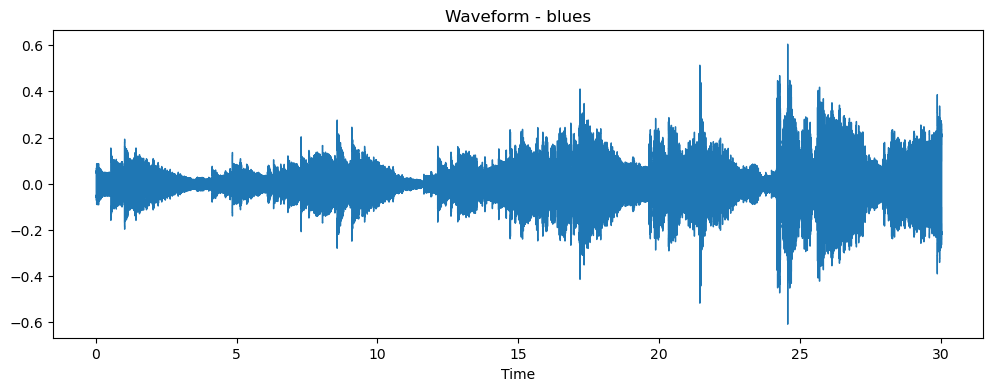

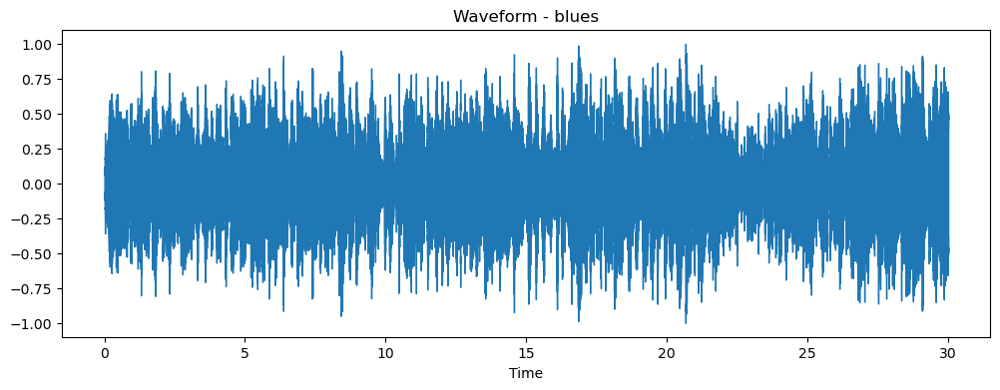

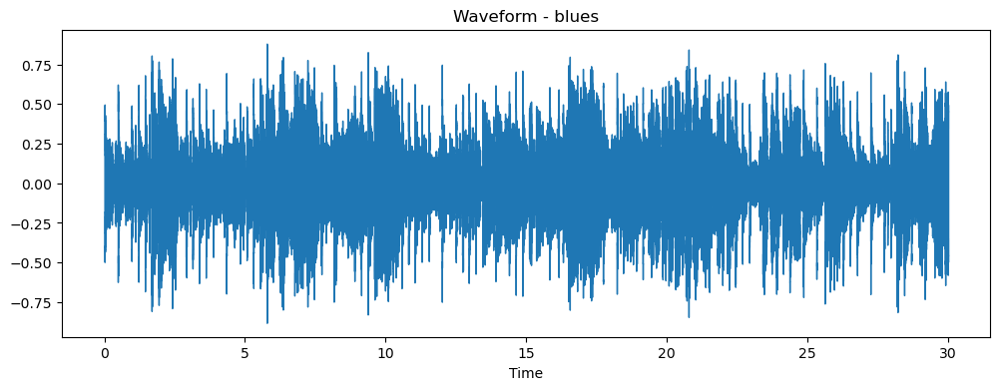

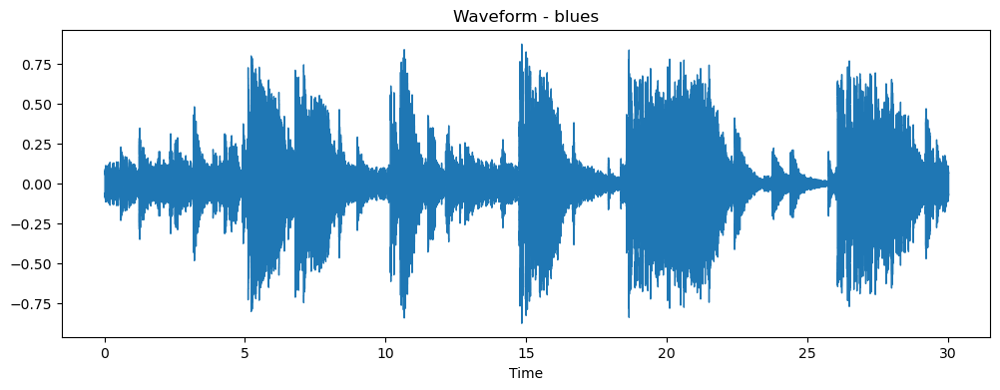

In [10]:
# Function to visualize the waveform
def visualize_waveform(y, sr, genre):
    plt.figure(figsize=(12, 4))
    librosa.display.waveshow(y, sr=sr)
    plt.title(f'Waveform - {genre}')
    plt.show()

# the path to the directory containing audio files for different genres
audio_directory = "C:/Users/Great Woman/Downloads/genres"  # Replace with your directory path

# Iterate through audio files in the directory for a specific genre
genre = "blues"  # Replace with the genre you want to visualize

for audio_file in os.listdir(os.path.join(audio_directory, genre)):
    audio_path = os.path.join(audio_directory, genre, audio_file)
    y, sr = librosa.load(audio_path)
    
    # Visualize the waveform
    visualize_waveform(y, sr, genre)


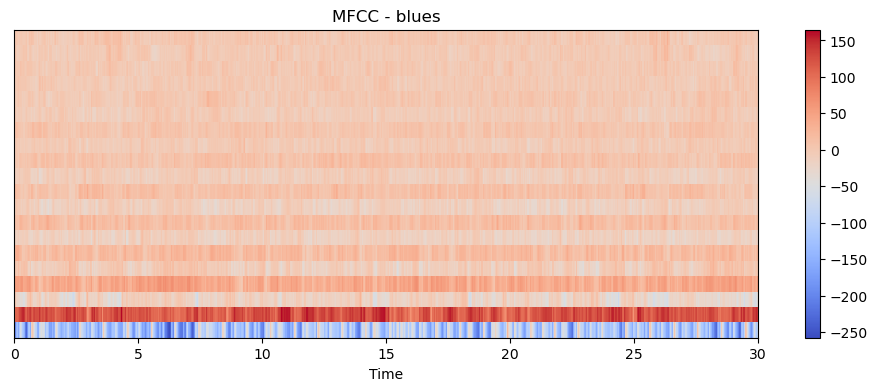

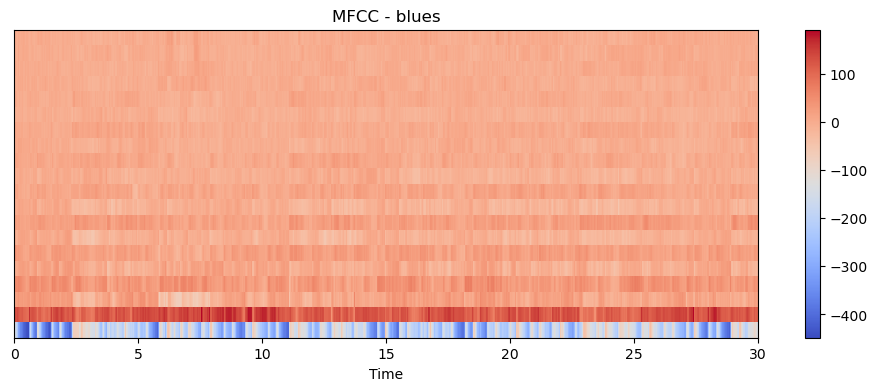

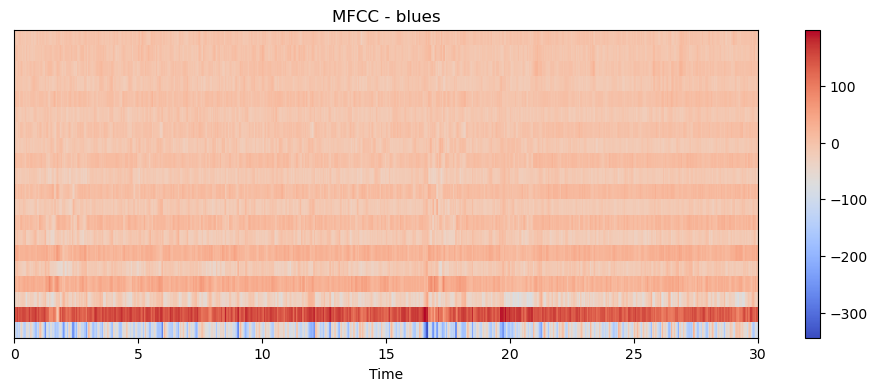

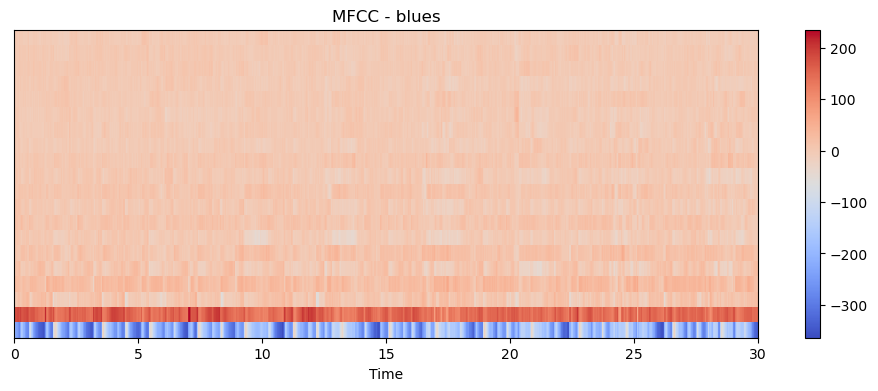

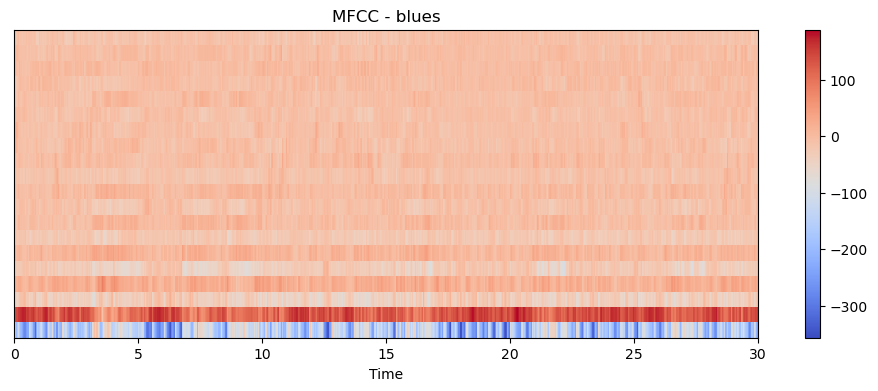

...

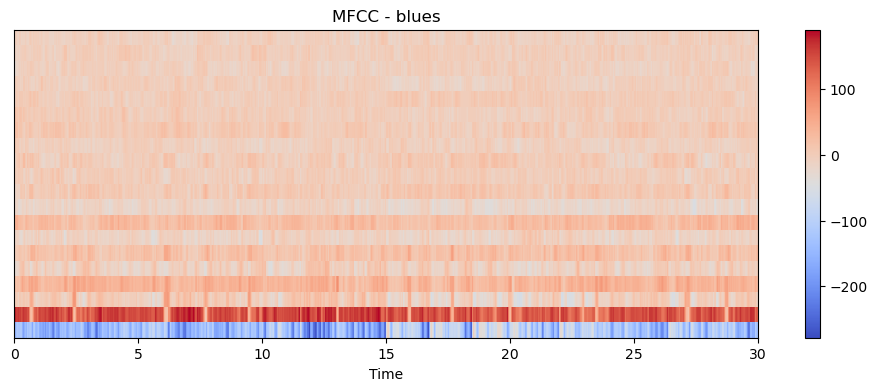

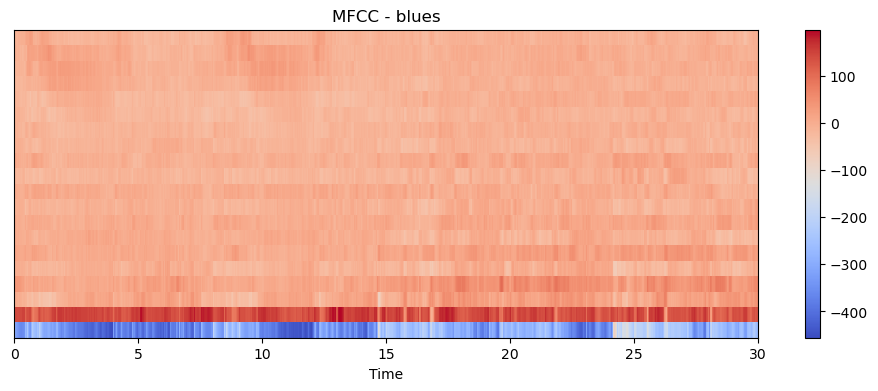

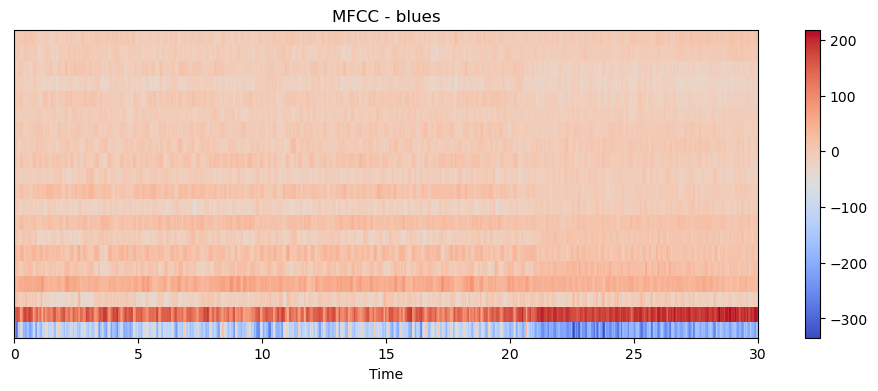

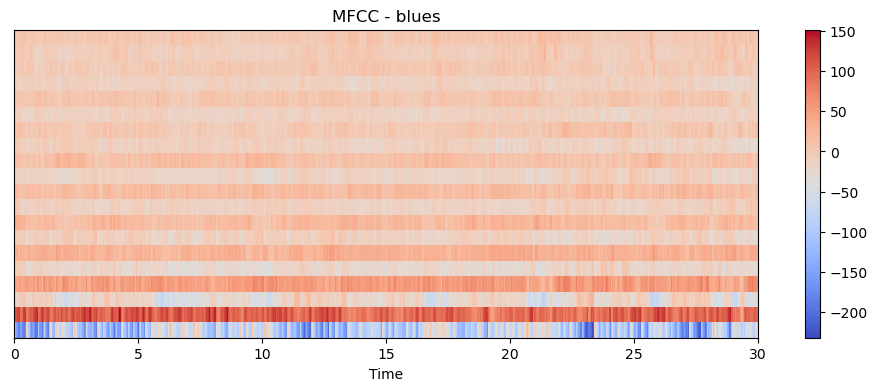

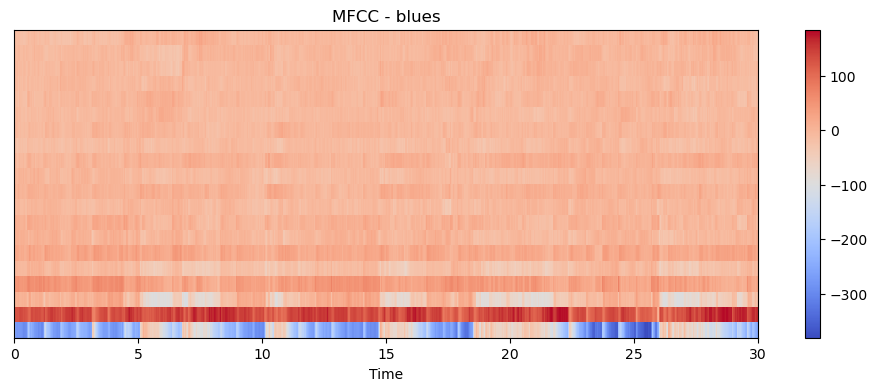

In [11]:
# Function to visualize the MFCC spectrogram
def visualize_mfcc(y, sr, genre):
    mfccs = librosa.feature.mfcc(y=y, sr=sr)
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 1, 1)
    librosa.display.specshow(mfccs, x_axis='time')
    plt.colorbar()
    plt.title(f'MFCC - {genre}')
    plt.show()

# Iterate through audio files in the directory for a specific genre
for audio_file in os.listdir(os.path.join(audio_directory, genre)):
    audio_path = os.path.join(audio_directory, genre, audio_file)
    y, sr = librosa.load(audio_path)
    
    # Visualize the MFCC spectrogram
    visualize_mfcc(y, sr, genre)


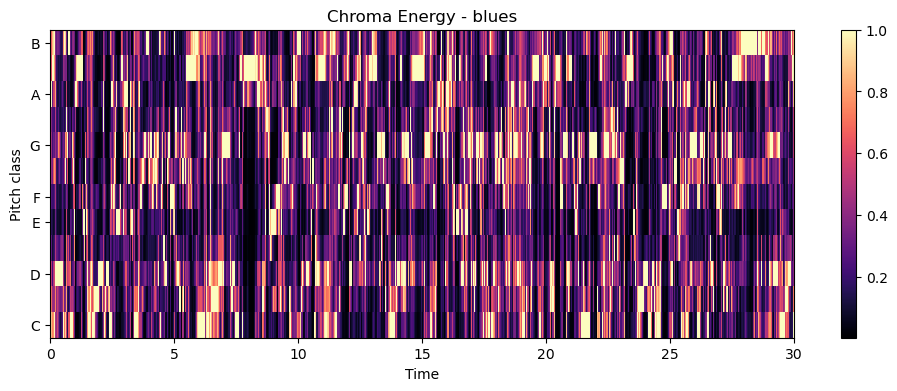

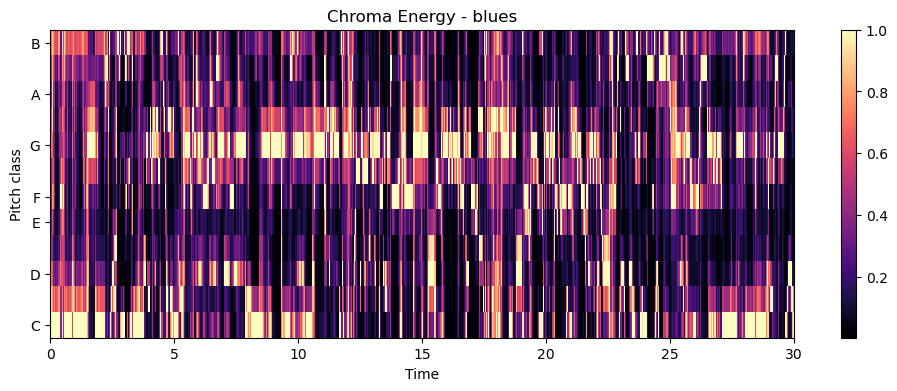

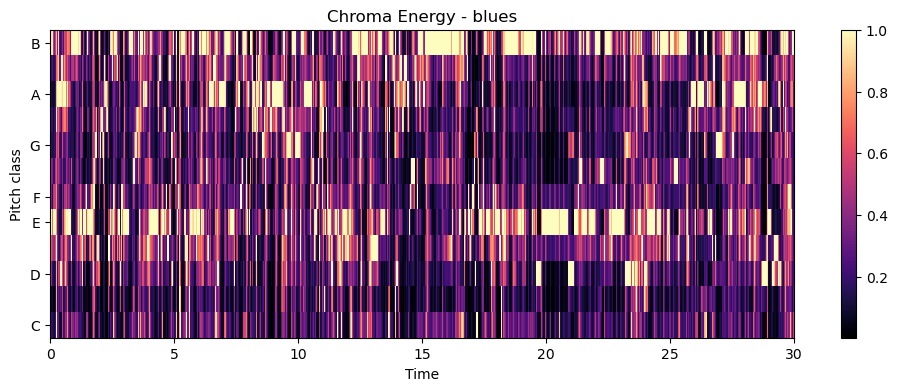

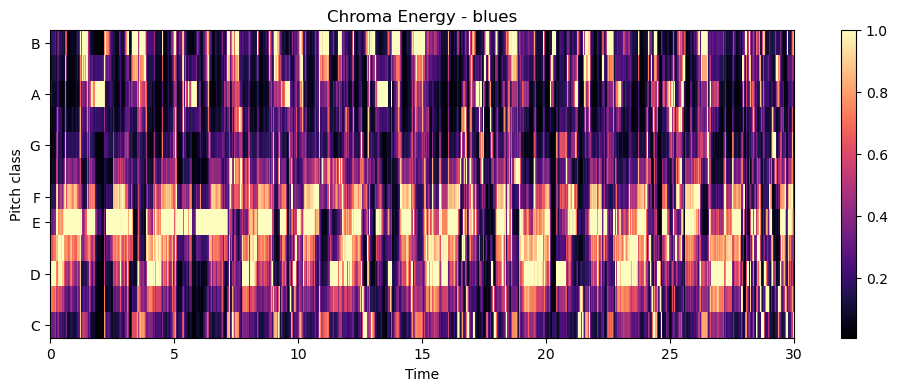

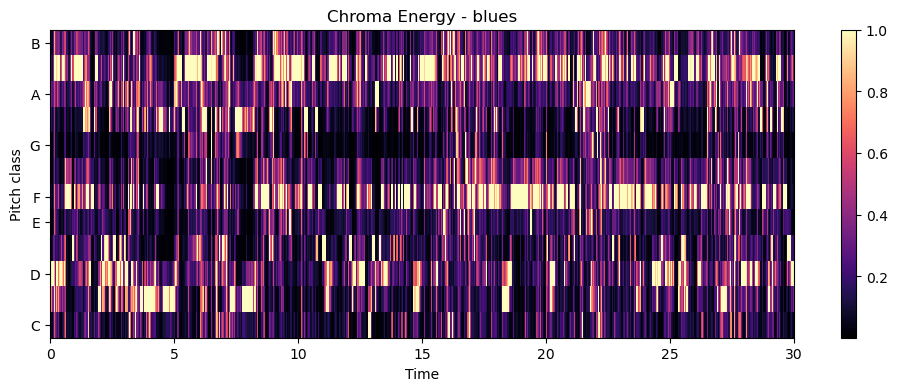

...

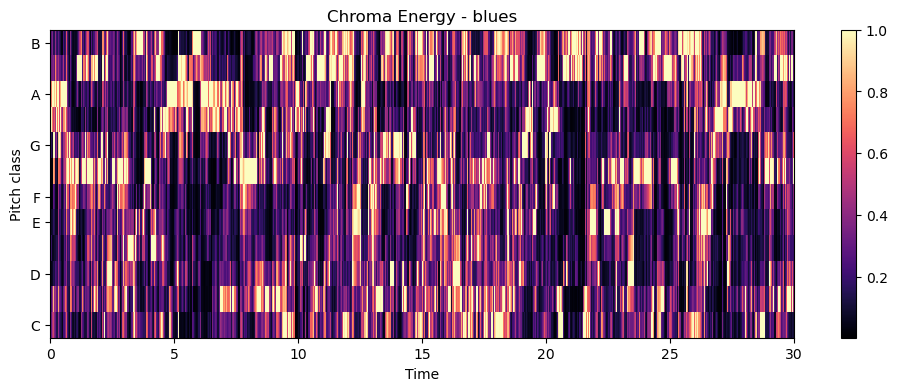

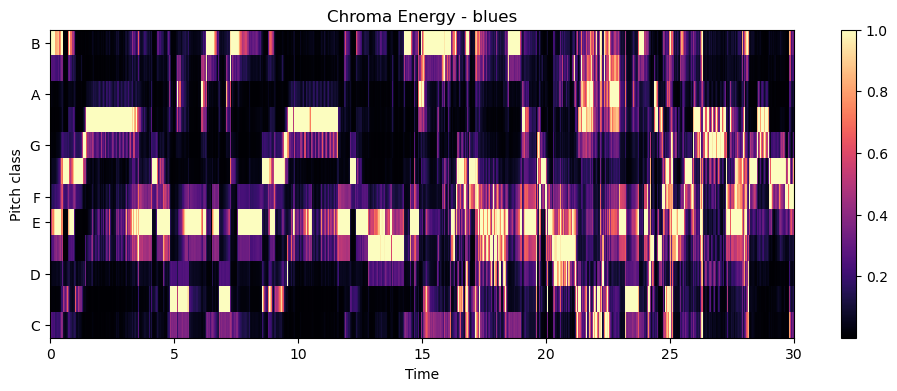

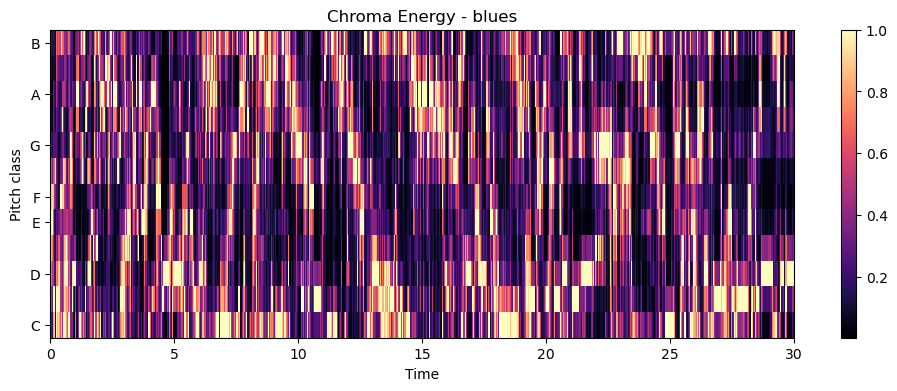

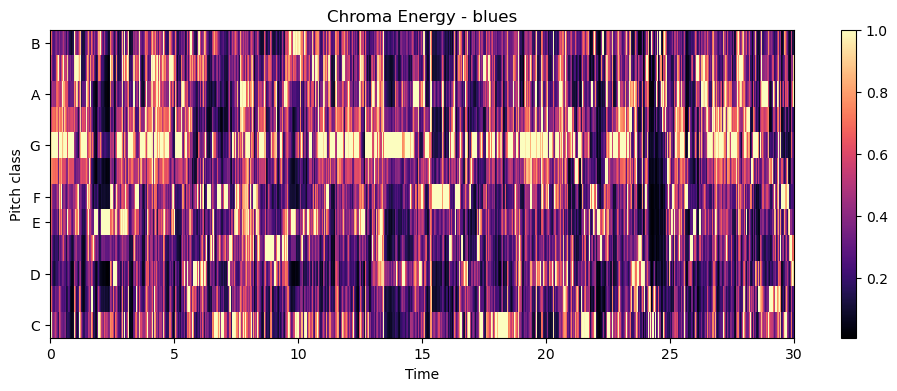

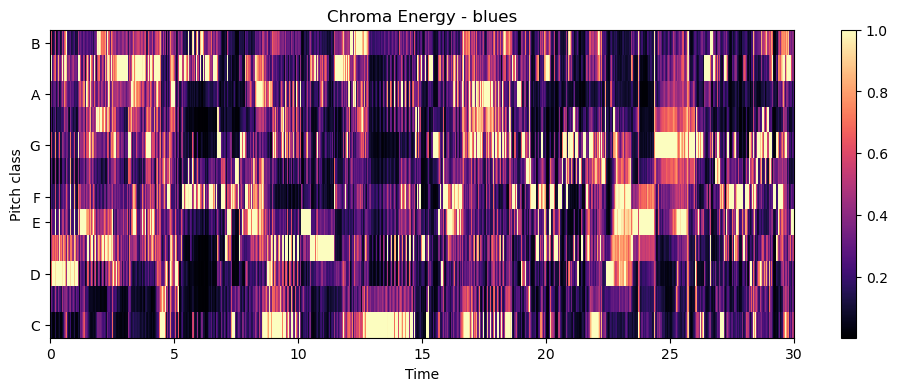

In [12]:
# Function to visualize the Chroma Energy spectrogram
def visualize_chroma_energy(y, sr, genre):
    chroma = librosa.feature.chroma_stft(y=y, sr=sr)
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 1, 1)
    librosa.display.specshow(chroma, y_axis='chroma', x_axis='time')
    plt.colorbar()
    plt.title(f'Chroma Energy - {genre}')
    plt.show()

# Iterate through audio files in the directory for a specific genre
for audio_file in os.listdir(os.path.join(audio_directory, genre)):
    audio_path = os.path.join(audio_directory, genre, audio_file)
    y, sr = librosa.load(audio_path)
    
    # Visualize the Chroma Energy spectrogram
    visualize_chroma_energy(y, sr, genre)


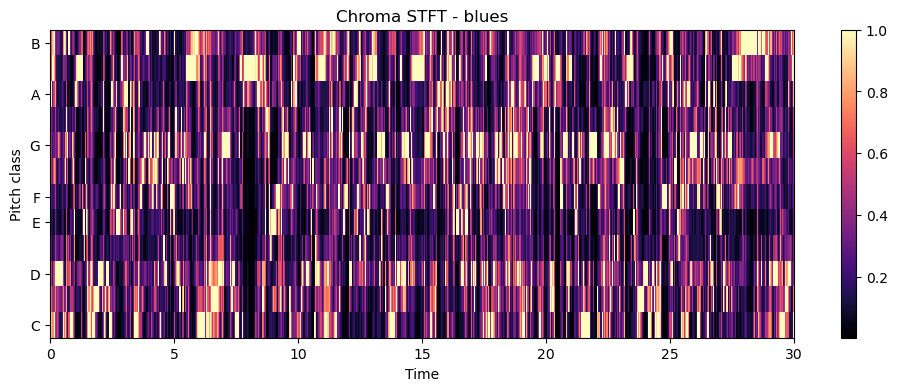

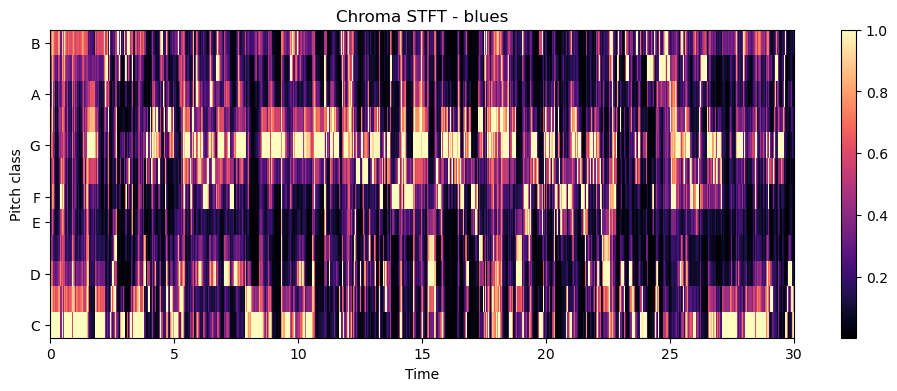

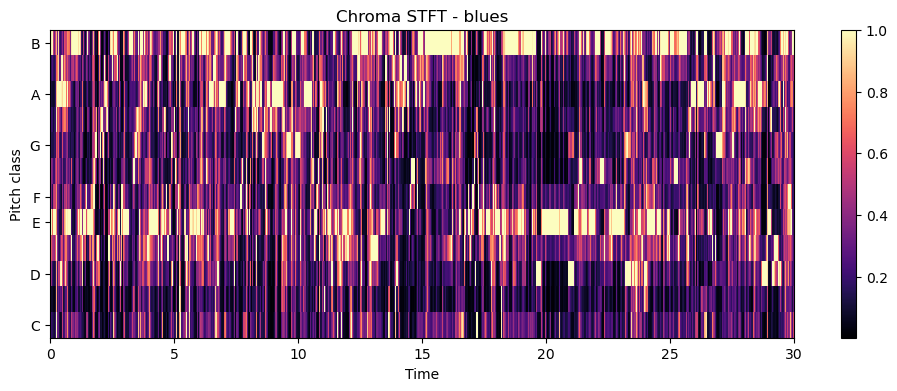

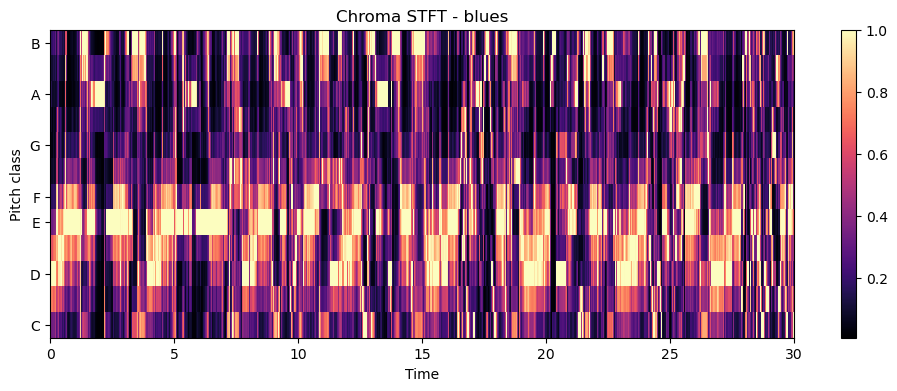

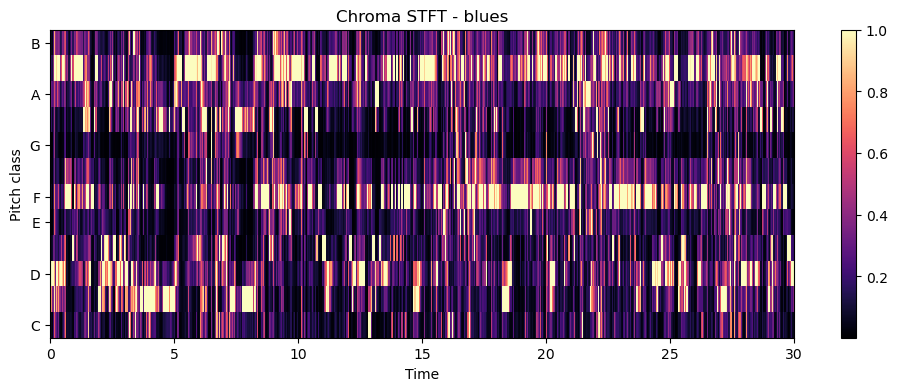

...

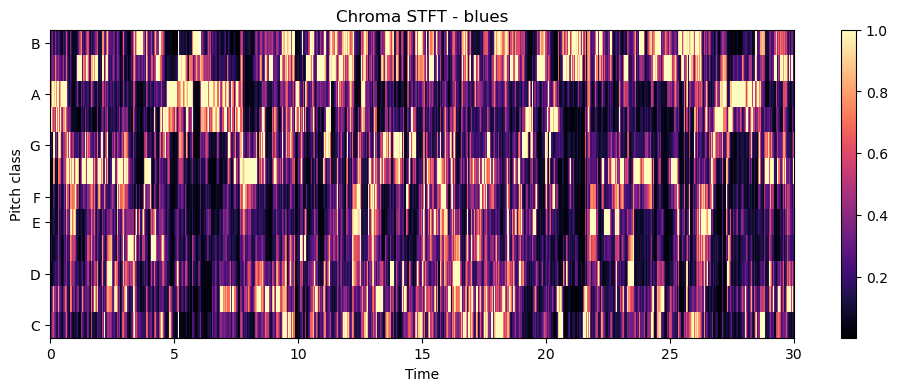

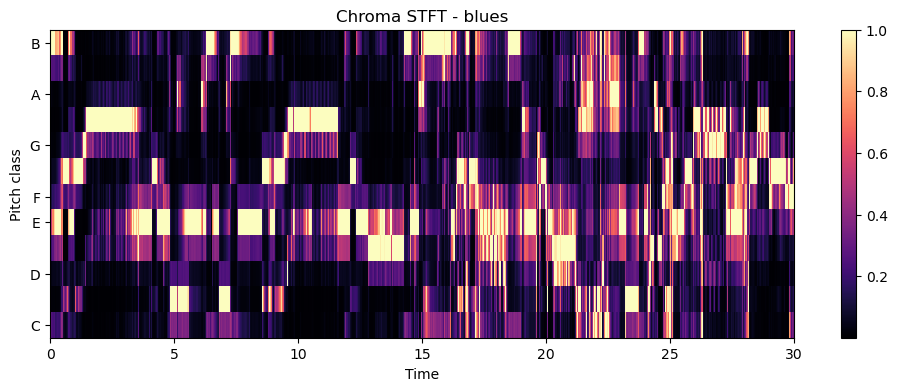

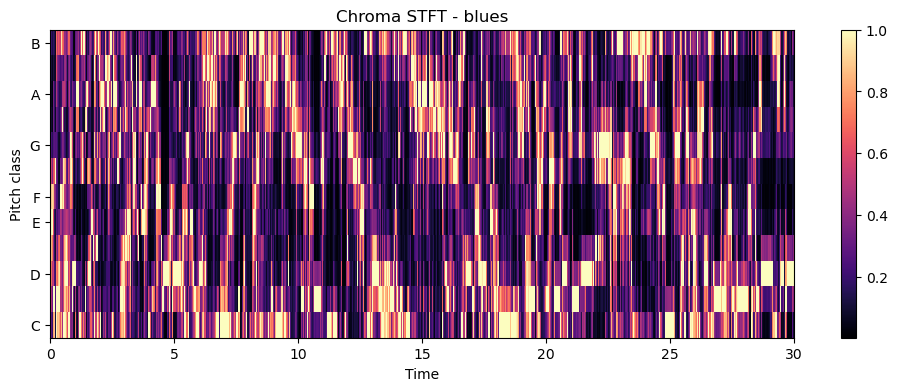

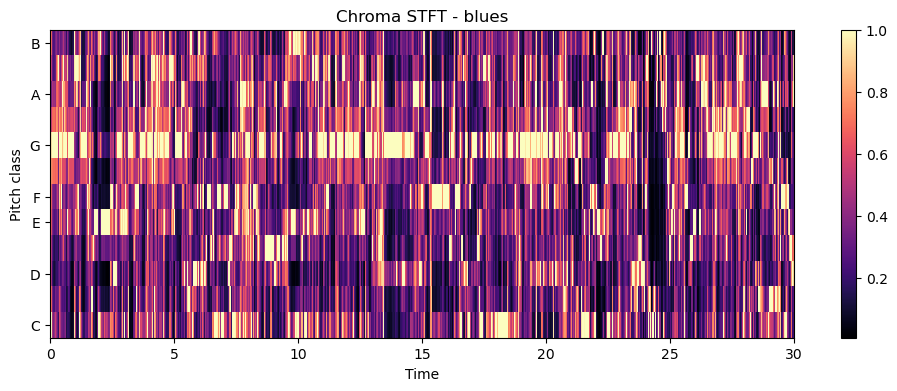

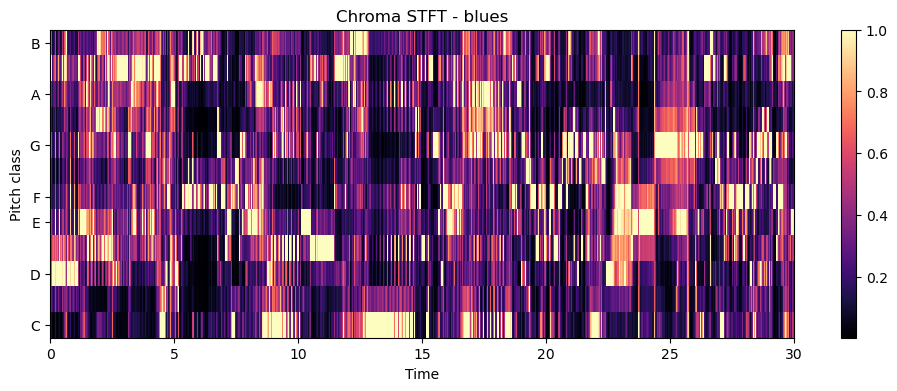

In [13]:
# Function to visualize the Chroma STFT spectrogram
def visualize_chroma_stft(y, sr, genre):
    chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 1, 1)
    librosa.display.specshow(chroma_stft, y_axis='chroma', x_axis='time')
    plt.colorbar()
    plt.title(f'Chroma STFT - {genre}')
    plt.show()

# Iterate through audio files in the directory for a specific genre
for audio_file in os.listdir(os.path.join(audio_directory, genre)):
    audio_path = os.path.join(audio_directory, genre, audio_file)
    y, sr = librosa.load(audio_path)
    
    # Visualize the Chroma STFT spectrogram
    visualize_chroma_stft(y, sr, genre)


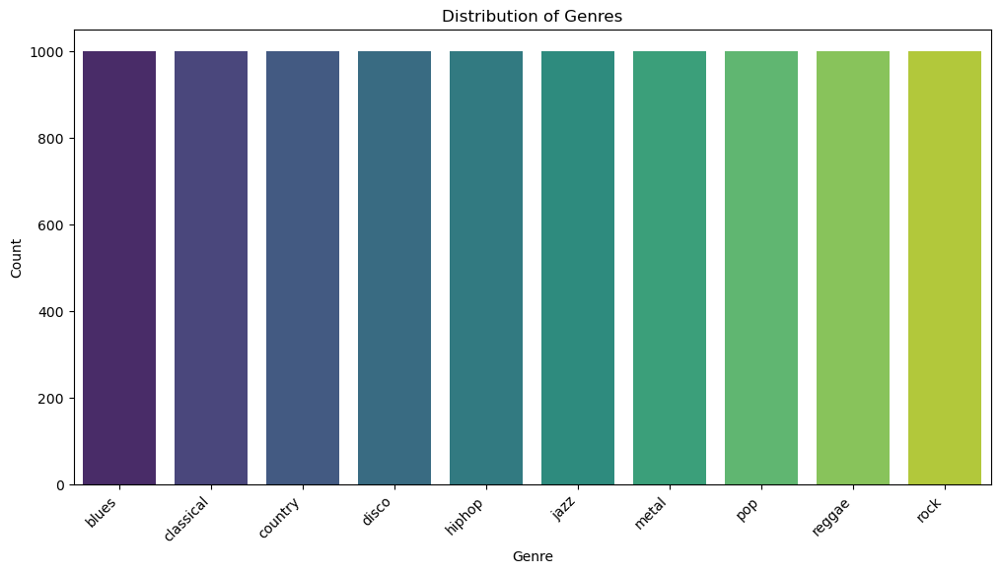

In [14]:
# Load the CSV file into a DataFrame
csv_file_path = "genres_output.csv"  # Update with the path to your CSV file
data = pd.read_csv(csv_file_path)

# Plot the distribution of genres
plt.figure(figsize=(12, 6))
sns.countplot(x='genre', data=data, palette='viridis')
plt.title('Distribution of Genres')
plt.xlabel('Genre')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.show()


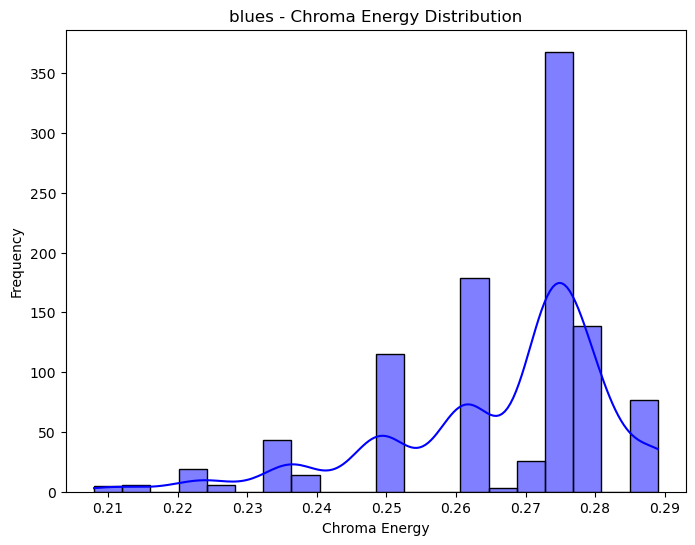

In [15]:
# Choose a specific genre
genre1 = "blues"

# Filter data for the selected genre
genre1_data = data[data['genre'] == genre1]

# Visualize the distribution of a specific feature for Genre 1
plt.figure(figsize=(8, 6))
sns.histplot(genre1_data['chroma_energy'], bins=20, kde=True, color='blue')
plt.title(f'{genre1} - Chroma Energy Distribution')
plt.xlabel('Chroma Energy')
plt.ylabel('Frequency')
plt.show()


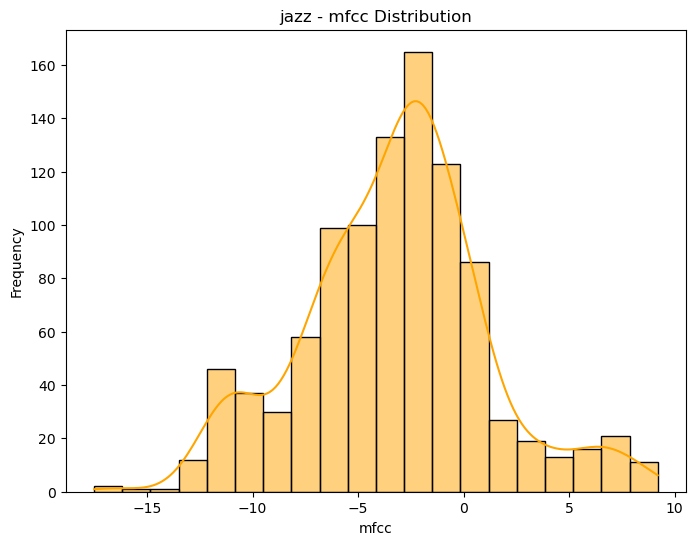

In [16]:
# Choose another genre
genre2 = "jazz"

# Filter data for the selected genre
genre2_data = data[data['genre'] == genre2]

# Visualize the distribution of a specific feature for Genre 2
plt.figure(figsize=(8, 6))
sns.histplot(genre2_data['mfcc'], bins=20, kde=True, color='orange')
plt.title(f'{genre2} - mfcc Distribution')
plt.xlabel('mfcc')
plt.ylabel('Frequency')
plt.show()


# MACHINE LEARNING

In [17]:


# Select the features to be scaled (replace with your actual feature names)
features_to_scale = ['mfcc', 'zero_crossing_rate', 'chroma_energy']

# Perform Standard Scaling
scaler = StandardScaler()
data[features_to_scale] = scaler.fit_transform(data[features_to_scale])

# Display the scaled data
data.head()



,chroma_energy,mfcc,chroma_stft,zero_crossing_rate,spectral_centroid,spectral_rolloff,genre
0,0.275434,-0.238425,0.544,0.281983,2175.901,4866.504,blues
1,0.275434,-0.349161,0.487,0.647758,2274.846,4984.937,blues
2,0.208632,-0.269527,0.376,0.874191,2093.052,4521.973,blues
3,0.442439,-0.300377,0.373,0.839355,2088.211,4489.673,blues
4,0.442439,-0.355306,0.403,0.560669,2218.008,4694.238,blues


In [18]:
# data is stored in a CSV file
file_path = "genres_output.csv"
data = pd.read_csv(file_path)

# 'genre' is the column containing the labels
labels = data['genre']

# other columns are features
features = data.drop('genre', axis=1)  # Drop the 'genre' column to keep only features

# Display the real feature data
print("Real Feature Data:")
print(features.head())

# Display the real label data
print("\nReal Label Data:")
print(labels.value_counts())


Real Feature Data:
   chroma_energy   mfcc  chroma_stft  zero_crossing_rate  spectral_centroid  \
0          0.275 -3.730        0.544               0.090           2175.901   
1          0.275 -4.613        0.487               0.111           2274.846   
2          0.273 -3.978        0.376               0.124           2093.052   
3          0.280 -4.224        0.373               0.122           2088.211   
4          0.280 -4.662        0.403               0.106           2218.008   

   spectral_rolloff  
0          4866.504  
1          4984.937  
2          4521.973  
3          4489.673  
4          4694.238  

Real Label Data:
blues        1000
classical    1000
country      1000
disco        1000
hiphop       1000
jazz         1000
metal        1000
pop          1000
reggae       1000
rock         1000
Name: genre, dtype: int64


In [19]:
# Load data
file_path = "genres_output.csv"  # Replace with the actual path to your dataset
data = pd.read_csv(file_path)

#  'genre' is the column containing the labels
labels = data['genre']

# other columns are features
features = data.drop('genre', axis=1)  # Drop the 'genre' column to keep only features

# Encode Labels
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(labels)

# Split the Data
X_train, X_test, y_train, y_test = train_test_split(features, labels_encoded, test_size=0.2, random_state=42, stratify=labels_encoded)

# Scale input features using StandardScaler
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define the neural network model using MLPClassifier (replace with your actual architecture)
model = MLPClassifier(hidden_layer_sizes=(128,), activation='relu', solver='adam', random_state=42)

# Train the model
model.fit(X_train_scaled, y_train)

# Evaluate the model
y_pred = model.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
confusion_mat = confusion_matrix(y_test, y_pred)

print("Test Accuracy:", accuracy)
print("Test Precision:", precision)
print("Test Recall:", recall)
print("Confusion Matrix:\n", confusion_mat)



Test Accuracy: 0.36
Test Precision: 0.34631504146526515
Test Recall: 0.36
Confusion Matrix:
 [[ 41  19  24  10  13  20  22   5  16  30]
 [ 11 150   9   2   0  18   1   0   5   4]
 [ 37  19  36   7  11  41  12  10  17  10]
 [ 19  10  16  25  13   9  33  25  14  36]
 [ 11   1   3  20  53  10  28  28  25  21]
 [ 28  21  21   6   1  69  11  15  17  11]
 [  9   0   2   9   9   6 122   9  15  19]
 [ 10   1   9  12  17   7  21  96  17  10]
 [ 18  13  12   5  15  15  23  14  67  18]
 [ 27   5  16  10   5  10  41  14  11  61]]


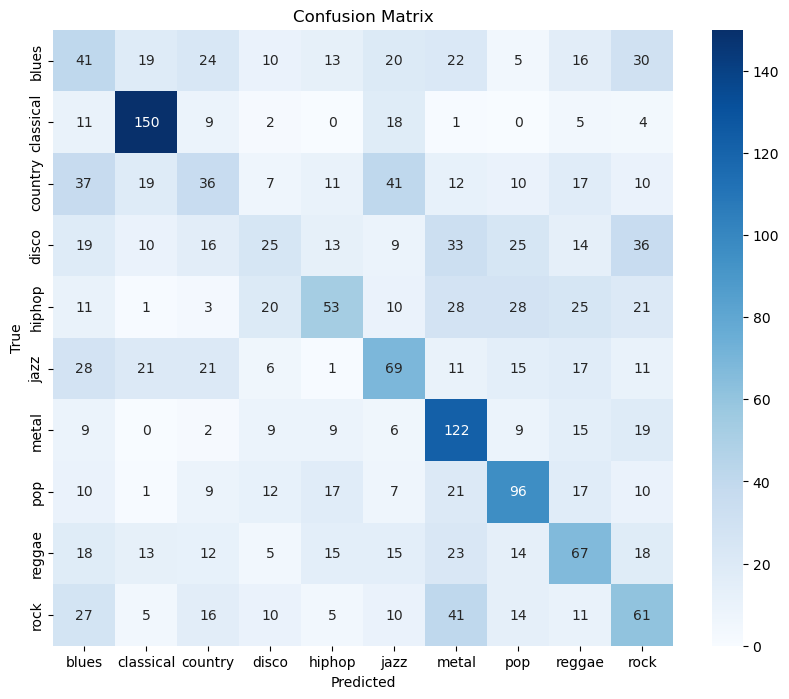

In [20]:
# y_test and y_pred are your true labels and predicted labels
cm = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()


In [21]:
# Define the Random Forest model
rf_model = RandomForestClassifier(random_state=42)

# Train the model
rf_model.fit(X_train_scaled, y_train)

# Evaluate the model
y_pred_rf = rf_model.predict(X_test_scaled)
accuracy_rf = accuracy_score(y_test, y_pred_rf)
precision_rf = precision_score(y_test, y_pred_rf, average='weighted')
recall_rf = recall_score(y_test, y_pred_rf, average='weighted')

print("Random Forest - Test Accuracy:", accuracy_rf)
print("Random Forest - Test Precision:", precision_rf)
print("Random Forest - Test Recall:", recall_rf)


Random Forest - Test Accuracy: 0.5165
Random Forest - Test Precision: 0.5124177775979312
Random Forest - Test Recall: 0.5165


In [22]:
# Define the XGBoost model
xgb_model = XGBClassifier(random_state=42)

# Train the model
xgb_model.fit(X_train_scaled, y_train)

# Evaluate the model
y_pred_xgb = xgb_model.predict(X_test_scaled)
accuracy_xgb = accuracy_score(y_test, y_pred_xgb)
precision_xgb = precision_score(y_test, y_pred_xgb, average='weighted')
recall_xgb = recall_score(y_test, y_pred_xgb, average='weighted')

print("XGBoost - Test Accuracy:", accuracy_xgb)
print("XGBoost - Test Precision:", precision_xgb)
print("XGBoost - Test Recall:", recall_xgb)


XGBoost - Test Accuracy: 0.461
XGBoost - Test Precision: 0.4573384208665947
XGBoost - Test Recall: 0.461


In [23]:
# Define the SVM model
svm_model = SVC(kernel='rbf', random_state=42)

# Train the model
svm_model.fit(X_train_scaled, y_train)

# Evaluate the model
y_pred_svm = svm_model.predict(X_test_scaled)
accuracy_svm = accuracy_score(y_test, y_pred_svm)
precision_svm = precision_score(y_test, y_pred_svm, average='weighted')
recall_svm = recall_score(y_test, y_pred_svm, average='weighted')

print("SVM - Test Accuracy:", accuracy_svm)
print("SVM - Test Precision:", precision_svm)
print("SVM - Test Recall:", recall_svm)


SVM - Test Accuracy: 0.3535
SVM - Test Precision: 0.34202486669194837
SVM - Test Recall: 0.3535


In [24]:
# Define the KNN model
knn_model = KNeighborsClassifier()

# Train the model
knn_model.fit(X_train_scaled, y_train)

# Evaluate the model
y_pred_knn = knn_model.predict(X_test_scaled)
accuracy_knn = accuracy_score(y_test, y_pred_knn)
precision_knn = precision_score(y_test, y_pred_knn, average='weighted')
recall_knn = recall_score(y_test, y_pred_knn, average='weighted')

print("KNN - Test Accuracy:", accuracy_knn)
print("KNN - Test Precision:", precision_knn)
print("KNN - Test Recall:", recall_knn)


KNN - Test Accuracy: 0.431
KNN - Test Precision: 0.43803590239246465
KNN - Test Recall: 0.431


In [25]:
# Create individual models
random_forest_model = RandomForestClassifier()
xgboost_model = XGBClassifier()

# Create an ensemble model
ensemble_model = VotingClassifier(estimators=[
    ('random_forest', random_forest_model),
    ('xgboost', xgboost_model),
], voting='hard')  # You can use 'soft' if the models provide probability estimates

# Fit the ensemble model
ensemble_model.fit(X_train, y_train)

# Evaluate the ensemble model
ensemble_accuracy = ensemble_model.score(X_test, y_test)
print("Ensemble Model Accuracy:", ensemble_accuracy)


Ensemble Model Accuracy: 0.4865


In [26]:
# Evaluate the model
y_pred = model.predict(X_test_scaled)

# Calculate precision and recall for each class without averaging
precision_per_class = precision_score(y_test, y_pred, average=None)
recall_per_class = recall_score(y_test, y_pred, average=None)

# Display precision and recall for each class
for label, precision_value, recall_value in zip(label_encoder.classes_, precision_per_class, recall_per_class):
    print(f"Class {label} - Precision: {precision_value:.4f}, Recall: {recall_value:.4f}")



Class blues - Precision: 0.1943, Recall: 0.2050
Class classical - Precision: 0.6276, Recall: 0.7500
Class country - Precision: 0.2432, Recall: 0.1800
Class disco - Precision: 0.2358, Recall: 0.1250
Class hiphop - Precision: 0.3869, Recall: 0.2650
Class jazz - Precision: 0.3366, Recall: 0.3450
Class metal - Precision: 0.3885, Recall: 0.6100
Class pop - Precision: 0.4444, Recall: 0.4800
Class reggae - Precision: 0.3284, Recall: 0.3350
Class rock - Precision: 0.2773, Recall: 0.3050
